<a href="https://colab.research.google.com/github/MRobalinho/Audio_Libraries/blob/master/Audio_Libraries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Audio Libraries

https://towardsdatascience.com/music-genre-classification-with-python-c714d032f0d8

https://wiki.python.org/moin/Audio/


## Librosa

It is a Python module to analyze audio signals in general but geared more towards music. 
It includes the nuts and bolts to build a MIR(Music information retrieval) system.

In [0]:
import librosa


In [5]:
# Readind (upload) Files
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving Carlos_Carmo_Por Morrer_Uma_Andorinha.mp3 to Carlos_Carmo_Por Morrer_Uma_Andorinha.mp3
User uploaded file "Carlos_Carmo_Por Morrer_Uma_Andorinha.mp3" with length 2836269 bytes


In [26]:
# Loading an audio file
audio_path = 'Carlos_Carmo_Por Morrer_Uma_Andorinha.mp3'
x , sr = librosa.load(audio_path)
print(type(x), type(sr))



<class 'numpy.ndarray'> <class 'int'>


In [27]:
print(x.shape, sr)


(3907116,) 22050


In [13]:
# This returns an audio time series as a numpy array with a default sampling rate(sr) of 22KHZ mono. 
# We can change this behaviour by saying:

xx , srx = librosa.load(audio_path, sr=44100)
print(xx.shape, srx)

(7814232,) 44100


In [17]:
# Play Audio File

import IPython.display as ipd

ipd.Audio(audio_path)


In [0]:
# Visualizing Audio - Waveform
# We can plot the audio array using librosa.display.waveplot:

%matplotlib inline
import matplotlib.pyplot as plt

import librosa.display


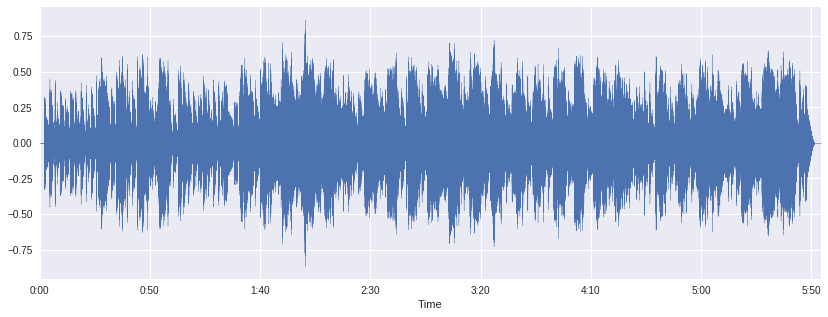

In [19]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

In [0]:
# Spectrogram

# A spectrogram is a visual representation of the spectrum of frequencies of sound or other signals as they vary with time.
# Spectrograms are sometimes called sonographs, voiceprints, or voicegrams. When the data is represented in a 3D plot, 
# they may be called waterfalls. In 2-dimensional arrays, the first axis is frequency while the second axis is time.

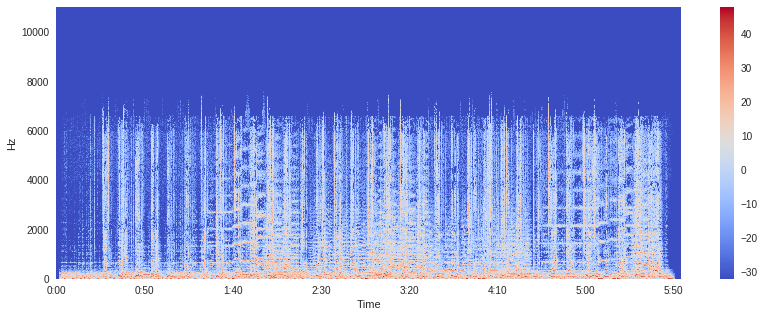

In [21]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))

plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

In [0]:
# Writing Audio
# librosa.output.write_wav saves a NumPy array to a WAV file.

file2 = 'example.wav'
librosa.output.write_wav(file2, x, sr)

In [29]:
# Play Audio File example


ipd.Audio(file2)

## Creating an audio signal

Let us now create an audio signal at 220Hz. An audio signal is a numpy array, 
so we shall create one and pass it into the audio function.

In [36]:
import numpy as np

sr = 22050 # sample rate
T = 5.0    # seconds

t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.5*np.sin(2*np.pi*220*t)    # pure sine wave at 220 Hz

print(x)

[ 0.          0.03132416  0.06252526 ... -0.09348072 -0.06252526
 -0.03132416]


In [38]:

# Playing the audio
ipd.Audio(x, rate=sr) # load a NumPy array

In [0]:
# Saving the audio

librosa.output.write_wav('tone_220.wav', x, sr)

## Feature extraction
Every audio signal consists of many features. However, we must extract the characteristics that are relevant to the problem we are trying to solve. The process of extracting features to use them for analysis is called feature extraction. Let us study about few of the features in detail.

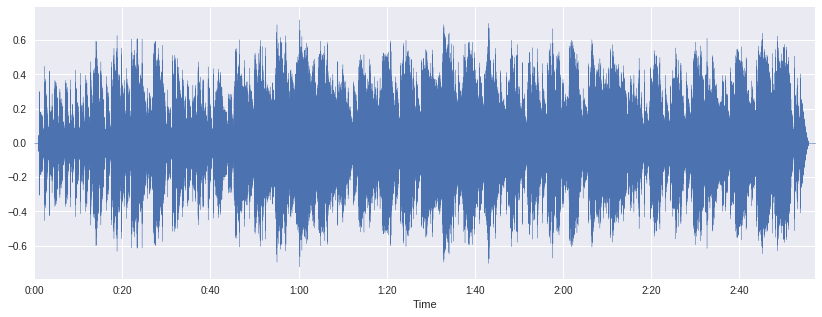

In [39]:
# Let us calculate the zero crossing rate for our example audio clip.
# Load the signal
x, sr = librosa.load(audio_path)

#Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

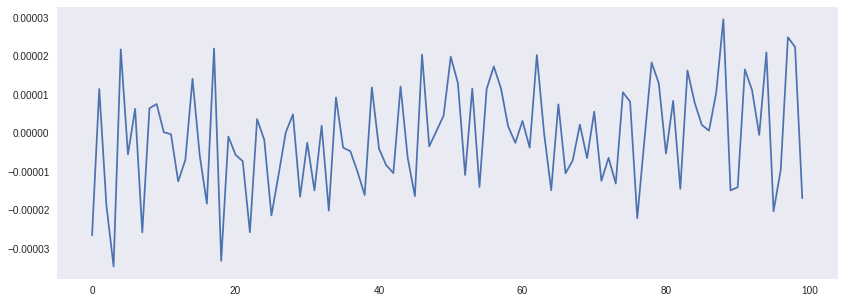

In [40]:
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [0]:
# Centroid

# It indicates where the ”centre of mass” for a sound is located and is calculated as the weighted mean of the frequencies 
# present in the sound. Consider two songs, one from a blues genre and the other belonging to metal. Now as compared to 
# the blues genre song which is the same throughout its length, the metal song has more frequencies towards the end.
# So spectral centroid for blues song will lie somewhere near the middle of its spectrum while that for a metal song would be towards its end.

In [42]:
Spectral Rolloff
It is a measure of the shape of the signal. It represents the frequency below which a specified percentage of the total spectral energy, e.g. 85%, lies.spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
spectral_centroids.shape 


(7632,)

In [0]:
import sklearn

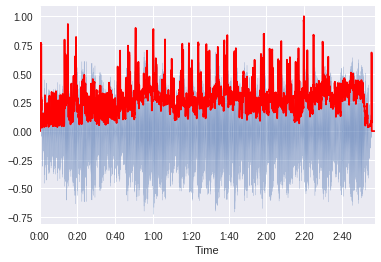

In [45]:
# Computing the time variable for visualization
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

  #Plotting the Spectral Centroid along the waveform
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

In [0]:
# Spectral Rolloff

# It is a measure of the shape of the signal. It represents the frequency below which a specified percentage
# of the total spectral energy, e.g. 85%, lies.

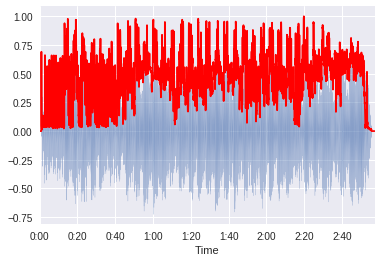

In [48]:
spectral_rolloff = librosa.feature.spectral_rolloff(x+0.01, sr=sr)[0]
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

In [0]:
# Mel-Frequency Cepstral Coefficients

# The Mel frequency cepstral coefficients (MFCCs) of a signal are a small set of features (usually about 10–20) 
# which concisely describe the overall shape of a spectral envelope. It models the characteristics of the human voice.

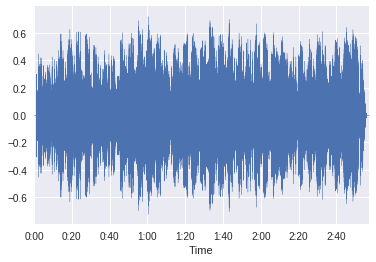

In [51]:
x, fs = librosa.load(audio_path)
librosa.display.waveplot(x, sr=sr)

(20, 7632)


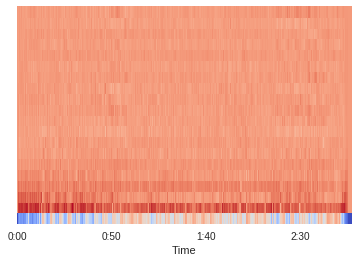

In [53]:
mfccs = librosa.feature.mfcc(x, sr=fs)
print (mfccs.shape)
(20, 97)

# Displaying  the MFCCs:
librosa.display.specshow(mfccs, sr=sr, x_axis='time')